# How to use Grassmannian Interpolation for blade interpolation

*Input to create interpolator*:
- 2D cross sections 
- locations of these cross sections along the blade span

*Requirements*:
- 2D cross sections parallel to each other 
- Equal number of landmarks (points defining cross section in 2D)
- Normalized location along the span $\eta\in[0, 1]$

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from g2aero.yaml_info import YamlInfo
from g2aero.Grassmann_interpolation import GrassmannInterpolator
from g2aero.transform import TransformBlade

# Simple demonstration: interpolation for a blade defined as .yaml file
Usually, a wind turbine blade definition is provided by a .yaml file which contains cross-sectional airfoils (normalized by chord size) and profiles of pitch axis (axis of twist), pitch angle (twist), scaling, and shift.

Our routine for blade interpolation consists of the following steps:
1. Read blade definition from the .yaml file and reparametrize given cross-section airfoils so they have equal number of landmarks.
2. Interpolate shapes between given cross-sections with unit chord
    * Normalize given (nominal) cross-section airfoils using Landmark-Affine transformation
    * Interpolate shapes between normalized cross-sections based on the geodesic
    * Apply inverse of Landmark-Affine transformation
3. Apply affine transformation to the interpolated shapes to scale, rotate, shift and bend (out-of-plane rotation) the blade according to the profiles provided in yaml file

This example also can be found as a script in `G2Aero/example/blade_interpolation.py`

## 1. Reading blade definition from .yaml file

Text(0.5, 1.0, 'Given nominal shapes')

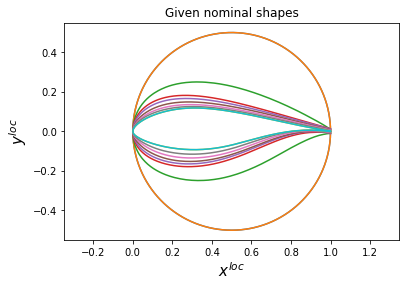

In [2]:
# shapes_filename = os.path.join(os.getcwd(), "data", "blades_yamls", "nrel5mw_ofpolars.yaml")
shapes_filename = os.path.join(os.getcwd(), "../../data", "blades_yamls", "IEA-15-240-RWT.yaml")

Blade = YamlInfo(shapes_filename, n_landmarks=401) # class object with information from .yaml file
xy_nominal = Blade.xy_landmarks # 2D nominal cross sections given in local coordinates (normalized by chord size)
eta_nominal = Blade.eta_nominal # locations of these cross sections along the blade span (Normalized span location from 0 to 1

fig, ax = plt.subplots(1, 1)
for i, xy in enumerate(xy_nominal):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_xlabel(r'$x^{loc}$', fontsize=15)
ax.set_ylabel(r'$y^{loc}$', fontsize=15)
ax.set_title('Given nominal shapes')

## 2. Interpolation

Text(0.5, 1.0, 'Interpolated shapes')

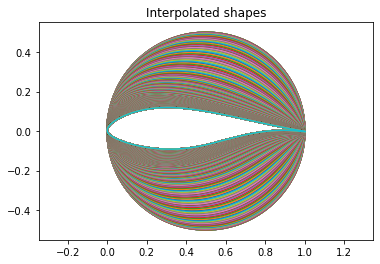

In [3]:
# 1. create interpolator object using spanwise locations and corresponding 2D cross-sections.
GrInterp = GrassmannInterpolator(eta_nominal, xy_nominal)
# 2. create array of spanwise locations where we want to get new interpolated cross-sections
eta_span = np.linspace(0, 1, 500)
# 3. Pass array of desired locations to created interpolator to get interpolated shapes
phys_crosssections = GrInterp(eta_span)

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
for i, xy in enumerate(phys_crosssections):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_title("Interpolated shapes")

## How Grassmannian interpolation works

###  1. Normalize given cross section shapes using Landmark-Affine transform

Shapes in physical space are given by a $n$ landmarks $\mathbf{x} = [x_{loc}, y_{loc}]^T$. Thus, a shape can be represented by $n\times 2$ matrix $\mathbf{X} = [\mathbf{x_1}, \dots, \mathbf{x_n}]^T$.

To represent physical airfoil shapes as elements of the Grassmannian, we apply Landmark-Affine (LA) standardization (Bryner et al. 2014). LA-standardization normalizes the shape such that it has zero mean and sample covariance proportional to $\mathbf{I}_2$ over the $n$ discrete landmarks defining the shape. The mapping between discrete airfoil $\mathbf{X}$ and the paired LA-standardized representation (denoted by $\tilde{\mathbf{X}}$) is an affine transformation
$$\mathbf{X} = \tilde{\mathbf{X}}M + B,$$
where $B = \mathbf{1} \rm{diag}(\mathbf{b})$ with $\mathbf{1}$ in $n\times 2$ matrix consisting of all ones and $\rm{diag}(\mathbf{b})$ is the two-dimensional center of mass of $\mathbf{X}$ and $M$ is invertible $2\times2$ matrix calculated using thin singular value decomposition (SVD) as $(\mathbf{X} – B)^{T} = U \Sigma V^T$ and $M = \Sigma U^T$. Note that then $\tilde{\mathbf{X}} = V$.

Text(0.5, 1.0, 'LA-standrdized shapes')

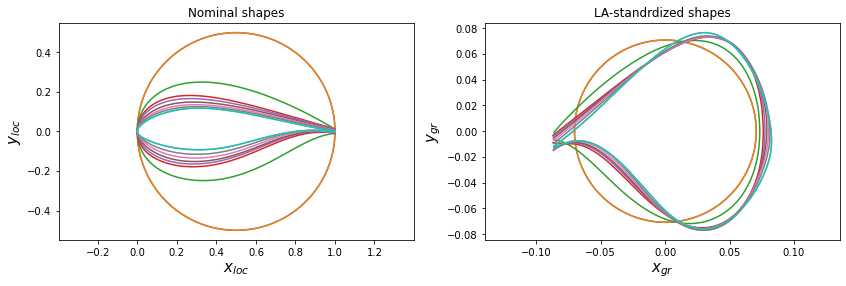

In [4]:
fig, ax = plt.subplots(1, 2, figsize=(14, 4))
for i, xy in enumerate(xy_nominal):
    ax[0].plot(xy[:, 0], xy[:, 1])
ax[0].axis('equal')
ax[0].set_xlabel(r'$x_{loc}$', fontsize=15)
ax[0].set_ylabel(r'$y_{loc}$', fontsize=15)
ax[0].set_title("Nominal shapes")

# LA-standardized shapes can be accessed as interpolator instance variable as GrInterp.xy_grassmann
for i, xy in enumerate(GrInterp.xy_grassmann):
    ax[1].plot(xy[:, 0], xy[:, 1])
ax[1].set_xlabel(r'$x_{gr}$', fontsize=15)
ax[1].set_ylabel(r'$y_{gr}$', fontsize=15)
ax[1].axis('equal')
ax[1].set_title("LA-standrdized shapes")

### 2. Interpolate M and b 
Elements of matrix $M$ and vector $\mathbf{b}$ are then interpolated along the blade span $\eta$
using Piecewise Cubic Hermite Interpolating Polynomial (PCHIP) interpolation.

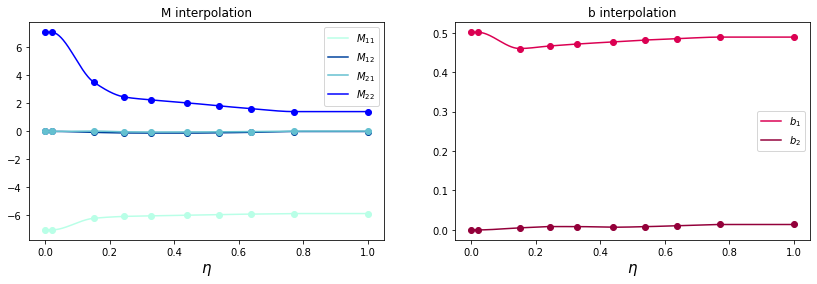

In [5]:
M = GrInterp.interpolator_M
b = GrInterp.interpolator_b
    
colors = ['#b9ffe7', '#00429d', '#64c0d0', 'b']
labels = [r'$M_{11}$', r'$M_{12}$', r'$M_{21}$', r'$M_{22}$']
fig, ax = plt.subplots(1, 2, figsize=(14, 4))
for i in range(4):
    ax[0].plot(eta_span, M(eta_span).reshape(-1, 4)[:, i], '-', color=colors[i], label=labels[i])
    ax[0].plot(eta_nominal, M(eta_nominal).reshape(-1, 4)[:, i], 'o', color=colors[i])
ax[0].set_xlabel(r'$\eta$', fontsize=15)
ax[0].set_title('M interpolation')
ax[0].legend(loc=0)
colors = ['#db0052', '#93003a']
labels = [r'$b_1$', r'$b_2$']
for i in range(2):
    ax[1].plot(eta_span, b(eta_span)[:, i], '-', color=colors[i], label=labels[i])
    ax[1].plot(eta_nominal, b(eta_nominal)[:, i], 'o', color=colors[i])
ax[1].set_xlabel(r'$\eta$', fontsize=15)
ax[1].set_title('b interpolation')
ax[1].legend(loc=0)

### 3. Calculate distance cdf

One of the benefits of using Grassmannian for interpolation is that the distance metric on Grassmann shows how shapes are different from each other. 


Text(0, 0.5, '$t$ (grassmannian)')

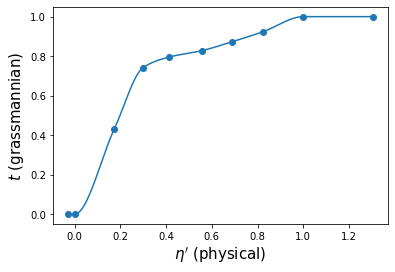

In [6]:
eta_span_scaled = GrInterp.eta_scaled(eta_span)

fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.scatter(GrInterp.eta_nominal_scaled, GrInterp.t_nominal)
ax.plot(eta_span_scaled, GrInterp.interpolator_cdf(eta_span_scaled))
ax.set_xlabel(r'$\eta^{\prime}$ (physical)', fontsize=15)
ax.set_ylabel(r'$t$ (grassmannian)', fontsize=15)

### 4. Interpolate using Geodesic
A geodesic is the shortest path between two points of a manifold and represents a generalized notion of the "straight line." Different airfoil shapes of the blade are represented as elements of the Grassmann manifold. To interpolate between these elements, we connect them with the shortest pathway on this manifold (geodesic). A geodesic path is defined by two initial conditions: the initial position and direction. A geodesic path can be parameterized by a scalar variable, denoted here by $t′$, so that it can be represented by a twice differentiable function  $\Phi(t')$, $0 \le t' \le 1$.In this case, $\Phi(0) = \tilde{\mathbf{X}}_i$ is the initial point of the geodesic and $\Phi(1)=\tilde{\mathbf{X}}_{i+1} $ its final point. In case of Grassmann manifold, geodesic can be calculated using method based on SVD.

Thus, to interpolate airfoil shape in any given spanwise position $\eta$ we 
1. find interval $\mathbf{X_i}$, $\mathbf{X}_{i+1}$; 
2. calculate the distance $t'$ from initial point $\mathbf{X}_i$ ($0 \le t' \le 1$) using cdf function (see above);
3. evaluate $\Phi(t')$.

If we want our interpolator to return not only physical interpolated shapes but interpolated LA-standardized shapes (elements on Grassmann) as well, we can pass argument `grassmann=True` to the interpolator.

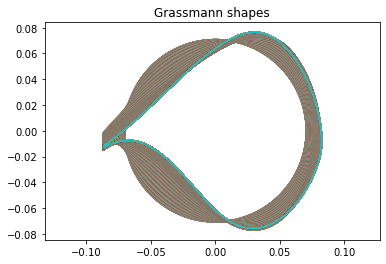

In [9]:
phys_span, gr_span = GrInterp(eta_span, grassmann=True)
    
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
for i, xy in enumerate(gr_span):
    ax.plot(xy[:, 0], xy[:, 1])
ax.axis('equal')
ax.set_title("Grassmann shapes")

### 5. Apply inverse transform
After we got interpolated LA-standardized shapes, we get interpolated physical shapes by simply apply inverse affine transformation
$$\mathbf{X}(\eta)=\mathbf{\tilde{X}}(\eta)𝑀(\eta)+𝐵(\eta),$$
where elements of matrices $M(\eta)$ and $B(\eta)$ are interpolated along the blade span using Piecewise Cubic Hermite Interpolating Polynomial (PCHIP) interpolation (as shown in 2.)

This will give us interpolated between given cross-section with unit chord. 

In [11]:
import plotly.graph_objects as go
from matplotlib.lines import Line2D

def plot_3d_blade(shapes, eta_span, shapes_nominal, eta_nominal):
    scale = 20
    N_eta_skp = 1
    N_arc_skp = 25
    line_b = go.scatter3d.Line(color = "#1f77b4",width = 1.)
    line_m = go.scatter3d.Line(color = "#db0052",width = 4.)
    data = []
    
#     TE_line_u = shapes[:, 0, :]
#     TE_line_l = shapes[:, shapes.shape[1]-1, :]
#     for i, shape in enumerate(shapes):
#         eta_span_z = np.repeat(eta_span[i], len(shape))*scale
#         data.append(go.Scatter3d(x=eta_span_z, y=shape[:, 0], z=shape[:, 1], mode='lines', line=line))
        
#     data.append(go.Scatter3d(x=eta_span*scale, y=TE_line_u[:, 0], z=TE_line_u[:, 1], mode='lines', line=line))
#     data.append(go.Scatter3d(x=eta_span*scale, y=TE_line_l[:, 0], z=TE_line_l[:, 1], mode='lines', line=line))
#     data.append(go.Scatter3d(x=eta_span_z, y=shapes[:, 0, 0], z=shapes[:, 0, 1], mode='lines', line=line))
    
    # Plot Grassmann interpolator cross section refinements    
    for i in range(0, int((shapes.shape[0])), N_eta_skp):
        eta_span_z = np.repeat(eta_span[i], shapes.shape[1])*scale
        data.append(go.Scatter3d(x=eta_span_z, y=shapes[i, :, 0], z=shapes[i, :, 1], mode='lines', line=line_b))
    
    # Plot tip
    i = int((shapes.shape[0]))-1
    eta_span_z = np.repeat(eta_span[i], shapes.shape[1])*scale
    data.append(go.Scatter3d(x=eta_span_z, y=shapes[i, :, 0], z=shapes[i, :, 1], 
                             mode='lines', line=line_b))
    
    # Plot span-wise landmarks
    span_line = np.empty((shapes.shape[1], shapes.shape[0], 2))
    for j in range(0, int((shapes.shape[1])), N_arc_skp):
        span_line[j] = shapes[:, j, :]
        data.append(go.Scatter3d(x=eta_span*scale, y=span_line[j, :, 0], z=span_line[j, :, 1], 
                                 mode='lines', line=line_b))
    
    
    # Plot nominal cross sections
    for i in range(0, int(shapes_nominal.shape[0])):
        eta = np.repeat(eta_nominal[i], shapes_nominal.shape[1])*scale
        nominal_x = shapes_nominal[i, :, 0].flatten()
        nominal_y = shapes_nominal[i, :, 1].flatten()
        data.append(go.Scatter3d(x=eta, y=nominal_x, z=nominal_y, mode='lines', line=line_m))
    
    fig = go.Figure(data=data)                     
    fig.update_layout(scene_aspectmode='data')
    fig.update_scenes(xaxis_visible=False, yaxis_visible=False,zaxis_visible=False )
#     fig.write_html(os.path.join(plot_folder, name))
    fig.show()

gr_nominal = np.empty((len(eta_nominal), GrInterp.n_landmarks, 2))
phys_nominal = np.empty((len(eta_nominal), GrInterp.n_landmarks, 2))
for i, eta in enumerate(eta_nominal):
    phys_nominal[i], gr_nominal[i] = GrInterp(eta, grassmann=True)
    
plot_3d_blade(phys_span, eta_span, phys_nominal, eta_nominal)

In [ ]:
## 

In [12]:
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.animation as animation
import plotly.graph_objects as go
mpl.rcParams['animation.embed_limit'] = 2**128

class SubplotAnimation(animation.TimedAnimation):
    def __init__(self, grassmann, eta_span_scaled, phys_nominal, gr_nominal, geodesic_gr, geodesic_phys, delay=150):

        font = {'family': 'times',
                'weight': 'bold',
                'size': 22}

        mpl.rc('font', **font)
        self.n = geodesic_gr.shape[0]
        self.n_shapes = phys_nominal.shape[0]
        self.geodesic_gr = geodesic_gr
        self.geodesic_phys = geodesic_phys
        self.x_phys = phys_nominal
        self.x_gr = gr_nominal
        self.eta_nominal = grassmann.eta_nominal_scaled
        self.eta_span = eta_span_scaled
        self.t_nominal = grassmann.t_nominal
        self.t_span = grassmann.interpolator_cdf(eta_span_scaled)

        gs_kw = dict(width_ratios=[1.5, 1, 1])
        fig, ax = plt.subplots(1, 3, figsize=(16, 5), constrained_layout=True, gridspec_kw=gs_kw)

        # Distances
        ax[0].axis('off')
        ax[0].set_aspect(0.25)
        ax[0].set_title('distance')
        ax[0].axis(ymin=-1, ymax=2)

        ax[0].add_artist(Line2D(np.linspace(self.eta_nominal[0], self.eta_nominal[-1], 1000), np.ones(1000), color='b'))
        ax[0].add_artist(Line2D(np.linspace(0, 1, 1000), np.zeros(1000), color='b'))
        ax[0].scatter(self.t_nominal, np.zeros(self.n_shapes), marker='o',
                      edgecolors='b', facecolor='None', s=50, linewidth=1)
        ax[0].scatter(self.eta_nominal, np.ones(self.n_shapes), marker='o',
                      edgecolors='b', facecolor='None', s=50, linewidth=1)
        ax[0].text(0.1, 1.2, 'physical')
        ax[0].text(0.1, 0.22, 'grassmann')

        # physical
        ax[1].axis('off')
        ax[1].axis('equal')
        ax[1].set_title('physical')
#         ax[1].axis(xmin=-3.5, xmax=4.5, ymin=-5., ymax=4)
        ax[1].axis(xmin=-0.3, xmax=1.3, ymin=-0.8, ymax=0.8)
        # grassmann
        ax[2].axis('off')
        ax[2].axis('equal')
        ax[2].set_title('grassmann')
        ax[2].axis(xmin=-0.12, xmax=0.12, ymin=-0.12, ymax=0.12)

        self.k_line = Line2D([], [], color='k')
        self.moving_dot = Line2D([], [], color='k', marker='o', markeredgecolor='k')

        self.g_dot = Line2D([], [], color='g', marker='o', markeredgecolor='g')
        self.r_dot = Line2D([], [], color='r', marker='o', markeredgecolor='r')
        ax[0].add_line(self.g_dot)
        ax[0].add_line(self.r_dot)
        ax[0].add_line(self.k_line)
        ax[0].add_line(self.moving_dot)

        self.k_line1 = Line2D([], [], color='k')
        self.moving_dot1 = Line2D([], [], color='k', marker='o', markeredgecolor='k')
        self.g_dot1 = Line2D([], [], color='g', marker='o', markeredgecolor='g')
        self.r_dot1 = Line2D([], [], color='r', marker='o', markeredgecolor='r')
        ax[0].add_line(self.g_dot1)
        ax[0].add_line(self.r_dot1)
        ax[0].add_line(self.k_line1)
        ax[0].add_line(self.moving_dot1)

        self.m_dot = Line2D([], [], color='m', marker='o', markeredgecolor='m')
        self.phys_shape = Line2D([], [], color='g', linewidth=2)
        self.phys_shape_next = Line2D([], [], color='r', linewidth=2)
        self.phys_moving = Line2D([], [], color='k', linewidth=1)
        ax[1].add_line(self.m_dot)
        ax[1].add_line(self.phys_shape)
        ax[1].add_line(self.phys_shape_next)
        ax[1].add_line(self.phys_moving)

        self.gr_shape = Line2D([], [], color='g', linewidth=2)
        self.gr_shape_next = Line2D([], [], color='r', linewidth=2)
        self.gr_moving = Line2D([], [], color='k', linewidth=1)
        ax[2].add_line(self.gr_shape)
        ax[2].add_line(self.gr_shape_next)
        ax[2].add_line(self.gr_moving)

        animation.TimedAnimation.__init__(self, fig, interval=delay, blit=True)

    def _draw_frame(self, framedata):
        i = framedata
        j = np.where(self.eta_span[i] >= self.eta_nominal)[0][-1]
        j_prev = np.where(self.eta_span[i-1] >= self.eta_nominal)[0][-1]
        if i == 0:
            j_prev = -1
        if j > j_prev:
            self.g_dot.set_data(self.t_nominal[j], 0)
            self.g_dot1.set_data(self.eta_nominal[j], 1)
            self.phys_shape.set_data(self.x_phys[j, :, 0], self.x_phys[j, :, 1])
            self.gr_shape.set_data(self.x_gr[j, :, 0], self.x_gr[j, :, 1])
            if j < self.n_shapes - 1:
                self.r_dot.set_data(self.t_nominal[j + 1], 0)
                self.r_dot1.set_data(self.eta_nominal[j + 1], 1)
                self.phys_shape_next.set_data(self.x_phys[j+1, :, 0], self.x_phys[j+1, :, 1])
                self.gr_shape_next.set_data(self.x_gr[j+1, :, 0], self.x_gr[j+1, :, 1])

        # grassmann line

        self.k_line.set_data(self.t_span[:i], np.zeros(i))
        self.moving_dot.set_data(self.t_span[i], 0)
        # physical line
        self.k_line1.set_data(self.eta_span[:i], np.ones(i))
        self.moving_dot1.set_data(self.eta_span[i], 1)

        # circles
        self.m_dot.set_data(self.geodesic_phys[i, 0, 0], self.geodesic_phys[i, 0, 1])
        self.phys_moving.set_data(self.geodesic_phys[i, :, 0], self.geodesic_phys[i, :, 1])
        self.gr_moving.set_data(self.geodesic_gr[i, :, 0], self.geodesic_gr[i, :, 1])

        self._drawn_artists = [self.k_line, self.moving_dot, self.g_dot, self.r_dot,
                               self.k_line1, self.moving_dot1, self.g_dot1, self.r_dot1,
                               self.phys_shape, self.phys_shape_next, self.phys_moving,
                               self.gr_shape, self.gr_shape_next, self.gr_moving, self.m_dot]

    def new_frame_seq(self):
        return iter(range(self.n))

    def _init_draw(self):
        lines = [self.moving_dot, self.k_line, self.g_dot, self.r_dot,
                 self.moving_dot1, self.k_line1, self.g_dot1, self.r_dot1,
                 self.phys_shape, self.phys_shape_next, self.phys_moving,
                 self.gr_shape, self.gr_shape_next, self.gr_moving, self.m_dot]
        for l in lines:
            l.set_data([], [])

In [ ]:
# from IPython.display import HTML
# plot_3d_blade_nominal(xy_nominal, eta_nominal, plot_folder, 'nominal_shapes_3D.html')